this is a pig healthy/ill classification test

In [2]:
import copy, pathlib, math
import PIL.Image as Image

import sklearn
import numpy
import matplotlib
import matplotlib.pyplot as plt

print("scikit-learn version:", sklearn.__version__)     # 1.1.3
print("numpy version:", numpy.__version__)              # 1.23.4
print("matplotlib version:", matplotlib.__version__)    # 3.6.2

scikit-learn version: 1.3.0
numpy version: 1.24.3
matplotlib version: 3.7.2



In real life the data provisioning phase is likely to include more steps about data sourcing and data quality, however for demo purposes in this notebook it is restricted to merely loading the images from the `data` folder, without any concern over quantity nor quality.

The code below will load the images and understand that the subfolder names are the class labels. It is important that all the images are the same size (and in this case square as well) so this code will automatically resize them. If high resolution images are available the `size` parameter can be increased and it will probably improve the performance slightly, at significantly increased training time. The given size of 256 is a middle way which is supposed to give fair results at a reasonable training time.

In [4]:
size = 256

def load_image(file, size):
    img = Image.open(file)
    img = img.resize((size, size))
    return numpy.array(img).flatten()

def load_labelled_images(path, size):
    labels = list()
    files = list()
    for file_info in [x for x in pathlib.Path(path).glob("**/*.jpg")]:
        labels.append(file_info.parts[1])
        files.append(str(file_info))
    imgs = numpy.array([load_image(f, size) for f in files])
    return imgs, numpy.array(labels)      

images, labels = load_labelled_images("./data", size)
print("Loaded", len(images), "images in the following", len(numpy.unique(labels)), "classes:")
for label in numpy.unique(labels):
    print(label)

Loaded 511 images in the following 2 classes:
healthy
ill



Given that this case uses images, there is no such thing as feature selection because one cannot select some pixels to be better indicators than other pixels beforehand. Therefore, there is little to do in terms of preprocessing other than splitting the dataset into a trainset and testset.

In [6]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=.3, random_state=0)



In this step the model will be fitted with the trainset only. In this case a [Support Vector Machine for classification](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html).

In [10]:
from sklearn.svm import SVC
model = SVC()
model.fit(X_train, y_train)
score = model.score(X_test, y_test)
print("Accuracy:", score)

Accuracy: 0.7467532467532467


in the step below you can test 1 image against the newly made model

In [25]:
from IPython.display import display
from ipywidgets import FileUpload
import numpy as np
from PIL import Image

# Set upload size to match model's input size
upload_size = 256

# File upload widget
uploader = FileUpload(accept='image/*', multiple=False)
display(uploader)

def preprocess_and_classify_image(uploaded_file):
    # Open and resize the image
    img = Image.open(uploaded_file)
    img = img.resize((upload_size, upload_size))
    img_data = np.array(img).flatten().reshape(1, -1)  # Flatten and reshape for model input
    
    # Use the trained model (assumes a variable `model` is defined in the notebook)
    prediction = model.predict(img_data)[0]  # Predict and get the class label
    



FileUpload(value=(), accept='image/*', description='Upload')

upoad an image and run the next box of code

In [26]:
from io import BytesIO

def preprocess_and_classify_image(uploaded_file):
    # Wrap memoryview in BytesIO
    img = Image.open(BytesIO(uploaded_file))
    img = img.resize((upload_size, upload_size))
    img_data = np.array(img).flatten().reshape(1, -1)  # Flatten and reshape for model input
    
    # Use the trained model (assumes a variable `model` is defined in the notebook)
    prediction = model.predict(img_data)[0]  # Predict and get the class label
    
    # Display result
    result = "Healthy" if prediction == 'healthy' else "Ill"
    print(f"Classification Result: The pig is classified as {result}.")

if uploader.value:
    uploaded_image = uploader.value[0]['content']  # Access the first (and only) item in the tuple and get 'content'
    preprocess_and_classify_image(uploaded_image)
else:
    print("Please upload an image to classify.")


Classification Result: The pig is classified as Ill.



Below a classification report is printed. This shows for every one of the classes how well the model performed.

In [8]:
from sklearn.metrics import classification_report
predictions = model.predict(X_test)
report = classification_report(y_test, predictions)
print(report)

              precision    recall  f1-score   support

     healthy       0.74      0.99      0.84       107
         ill       0.90      0.19      0.32        47

    accuracy                           0.75       154
   macro avg       0.82      0.59      0.58       154
weighted avg       0.79      0.75      0.68       154



It appears that Mewtwo is fairly hard to recognize, but the others all seem well. The code below will plot every pokemon in the testset, including the predicted label as well as whether this was correct or wrong.

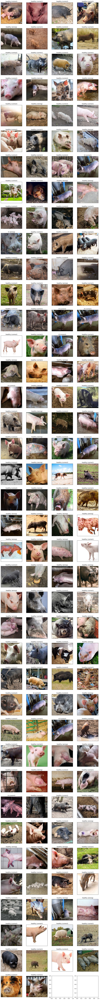

In [9]:
_, subplots = plt.subplots(nrows = math.ceil(len(X_test)/4), ncols = 4, figsize=(15, len(X_test)))
subplots = subplots.flatten()

for i, x in enumerate(X_test):
    subplots[i].imshow(numpy.reshape(x, [size, size, 3]))
    subplots[i].set_xticks([])
    subplots[i].set_yticks([])
    subplots[i].set_title(predictions[i] + (" (correct)" if predictions[i] == y_test[i] else " (wrong)"))